In [1]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation
from datetime import datetime

%matplotlib inline


In [2]:
load_dotenv()

True

In [3]:
# Cryptocurrencies
tickers = ["BTC", "ETH"]

# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=USD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=USD"

# Fetch current BTC price
my_btc = 1.2 

# Fetch current ETH price
my_eth = 5.3

# Compute current value of my crpto
my_btc_value = requests.get(btc_url).json()["data"]["1"]["quotes"]["USD"]["price"] 
my_eth_value = requests.get(eth_url).json()["data"]["1027"]["quotes"]["USD"]["price"] 

crypto= (my_btc_value*my_btc)+(my_eth_value*my_eth)

print(crypto)


15565.917


In [4]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("APCA_API_KEY")
alpaca_secret_key = os.getenv("APCA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version = "v2"
)

In [5]:
# Format current date as ISO format
today = pd.Timestamp(datetime.today()).isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
shares_df = api.get_barset(
    tickers,
    timeframe,
    start = today,
    end = today
).df

close_price= shares_df.xs("close", axis='columns', level=1)

# Preview DataFrame
close_price

,AGG,SPY
time,,
2020-05-28 00:00:00-04:00,117.330,302.9600
2020-05-29 00:00:00-04:00,117.670,304.1600
2020-06-01 00:00:00-04:00,117.365,305.5800
2020-06-02 00:00:00-04:00,117.450,308.1300
2020-06-03 00:00:00-04:00,117.160,312.2117
...,...,...
2020-10-12 00:00:00-04:00,117.930,352.4300
2020-10-13 00:00:00-04:00,118.010,350.1500
2020-10-14 00:00:00-04:00,118.040,347.9700


In [7]:
# Compute the current value of shares
spy_last_val = close_price["SPY"][-1] 
agg_last_val = close_price["AGG"][-1] 

my_spy= 50
my_agg= 200

spy_value= my_spy * spy_last_val
agg_value = my_agg * agg_last_val

shares = spy_value + agg_value

print(shares)

40938.5


In [8]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-10-14', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-10-14', tz='America/New_York').isoformat()

In [9]:
# Get 5 years' worth of historical data for SPY and AGG
df_stock_data = api.get_barset(tickers,
    timeframe,
    start=start_date,
    end=end_date
).df 
# Display sample data
df_stock_data.head()

AGG                                       \
                             open      high       low   close   volume   
time                                                                     
2015-10-14 00:00:00-04:00  109.83  110.0500  109.7251  110.03  3785661   
2015-10-15 00:00:00-04:00  109.93  110.0499  109.7900  109.89  1792325   
2015-10-16 00:00:00-04:00  109.90  109.9400  109.7800  109.78  1497588   
2015-10-19 00:00:00-04:00  109.78  109.8950  109.6500  109.85  1289942   
2015-10-20 00:00:00-04:00  109.64  109.7800  109.5500  109.65  1672562   

                              SPY                                      
                             open    high       low   close    volume  
time                                                                   
2015-10-14 00:00:00-04:00  200.18  200.87  198.9400  199.27  82856686  
2015-10-15 00:00:00-04:00  200.08  202.34  199.6400  202.33  96008389  
2015-10-16 00:00:00-04:00  202.83  203.29  201.9200  203.14  79323870  
2015-10-19 00:00:00-04:00  202.50  203.37  202.1300  203.33  61255929  
2015-10-20 00:00:00-04:00  202.85  203.84  202.5471  203.07  60081395

 Five Years Retirement Option

In [10]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
shares_weight = [.60, .40]
tickers= ["SPY", "AGG"]

num_sims = 500
MC_stocks_5years = MCSimulation(
    portfolio_data = df_stock_data,
    weights=shares_weight,
    num_simulation = num_sims,
    num_trading_days = 252*5
    
)


In [11]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
MC_stocks_5years.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.006015,1.001698,1.002690,0.999458,0.991324,0.988109,1.000600,0.991812,1.007609,1.000410,...,0.994930,0.998034,1.000546,1.002676,1.000657,1.002141,1.007961,1.004540,0.997121,0.998327
2,1.011079,1.010956,1.007182,0.998845,0.991831,0.988675,1.006797,0.998331,0.996334,1.004430,...,0.998484,0.999080,0.991702,0.998101,1.006027,1.005508,1.018439,1.004060,1.001808,1.001012
3,1.018042,1.009410,1.008351,1.001947,0.984838,0.993643,1.000057,1.002803,1.000665,1.000970,...,0.989314,0.996049,0.983335,0.998402,1.009518,1.003640,1.021624,1.002316,1.003574,1.000824
4,1.025128,1.014612,1.008773,0.999678,0.992270,0.997531,0.996438,0.997530,0.994763,1.001810,...,0.987714,0.998890,0.978295,0.997559,1.002049,1.007024,1.016860,1.005564,1.010266,0.991508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,1.162085,1.860206,1.391702,1.590783,1.959944,1.161597,1.158127,1.380380,1.664174,1.549021,...,1.033192,1.403796,1.401376,1.268838,1.529194,1.260384,1.091399,1.231524,1.239749,1.317003
1257,1.164064,1.866592,1.390259,1.586566,1.937505,1.168024,1.156112,1.390228,1.673648,1.543455,...,1.031570,1.393211,1.399769,1.260876,1.533379,1.256288,1.098815,1.226892,1.239922,1.324248
1258,1.162732,1.864682,1.390921,1.567204,1.928735,1.166969,1.155429,1.389273,1.692672,1.528626,...,1.036922,1.386471,1.406791,1.256897,1.534193,1.257269,1.107472,1.221337,1.241324,1.319406
1259,1.169474,1.879629,1.379552,1.563597,1.936719,1.170474,1.151549,1.394382,1.698941,1.522756,...,1.033216,1.398618,1.398204,1.253132,1.547462,1.255939,1.110339,1.230481,1.238488,1.317420


<AxesSubplot:title={'center':'500 Simulations of Cumulative Portfolio Return Trajectories Over the Next 1260 Trading Days.'}>

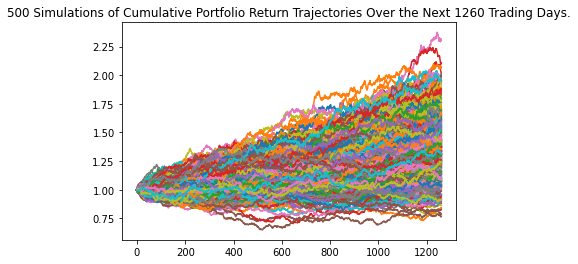

In [12]:
# Plot simulation outcomes
MC_stocks_5years.plot_simulation()

<AxesSubplot:title={'center':'Distribution of Final Cumuluative Returns Across All 500 Simulations'}, ylabel='Frequency'>

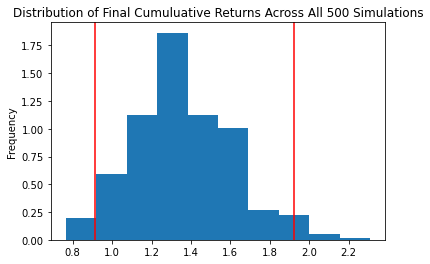

In [13]:
# Plot probability distribution and confidence intervals
MC_stocks_5years.plot_distribution()

In [14]:
# Fetch summary statistics from the Monte Carlo simulation results
results_5years= MC_stocks_5years.summarize_cumulative_return()

# Print summary statistics
print(results_5years)

count           500.000000
mean              1.359720
std               0.251085
min               0.765062
25%               1.182662
50%               1.341798
75%               1.527673
max               2.309355
95% CI Lower      0.913383
95% CI Upper      1.922800
Name: 1260, dtype: float64


In [16]:
# Set initial investment
initial_investment= 60000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
ci_lower_five = round(results_5years[8]*60000,2)
ci_upper_five = round(results_5years[9]*60000,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 5 years will end within in the range of $54802.96 and $115367.99


 Ten Years Retirement Option

In [17]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
shares_weight = [.60, .40]
tickers= ["SPY", "AGG"]

num_sims = 500
MC_stocks_10years = MCSimulation(
    portfolio_data = df_stock_data,
    weights=shares_weight,
    num_simulation = num_sims,
    num_trading_days = 252*10
    
)

In [18]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
MC_stocks_10years.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.007783,0.995382,0.998399,1.001647,0.995565,1.004128,1.004856,0.996915,0.996302,0.997972,...,1.007202,0.996232,1.001489,1.007671,1.007254,0.999522,1.005345,0.994203,0.994204,1.003275
2,1.006145,0.998407,0.998467,1.006691,1.001466,1.005975,1.009730,0.988403,0.990170,1.004823,...,1.001786,0.999309,0.994870,1.010401,1.011590,0.996469,1.005914,0.994013,0.987187,1.009927
3,1.005027,0.998695,1.004935,1.007037,1.010739,0.999918,1.011811,0.990398,0.991476,1.001923,...,0.999664,0.992062,0.998242,1.018258,1.007939,0.994140,1.013892,0.999507,0.987572,1.009254
4,1.005596,0.998882,1.004388,1.016610,1.010304,0.998583,1.009608,0.994860,0.990259,0.995319,...,0.992341,0.990022,0.997365,1.009817,1.004042,0.999675,1.009229,0.989628,0.987011,1.001231
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,1.648756,0.849090,1.683624,0.959763,1.860291,1.404258,1.798223,2.189147,1.763473,1.523911,...,1.035001,2.538987,1.708963,1.499112,2.269596,1.903326,1.559701,3.267166,1.536590,2.222818
2517,1.656848,0.854487,1.689017,0.954843,1.881250,1.408341,1.798095,2.196375,1.777741,1.515692,...,1.039580,2.550011,1.715013,1.493489,2.276271,1.914186,1.556892,3.267597,1.547743,2.225274
2518,1.650620,0.860186,1.688820,0.940492,1.901696,1.411221,1.790906,2.177976,1.794390,1.501453,...,1.036782,2.553684,1.724532,1.498753,2.260792,1.908507,1.559645,3.274208,1.546569,2.214361
2519,1.655469,0.866138,1.682222,0.930972,1.913589,1.414213,1.779112,2.168533,1.792318,1.506290,...,1.042428,2.562206,1.723394,1.511597,2.268450,1.893846,1.553335,3.251173,1.555741,2.221033


<AxesSubplot:title={'center':'500 Simulations of Cumulative Portfolio Return Trajectories Over the Next 2520 Trading Days.'}>

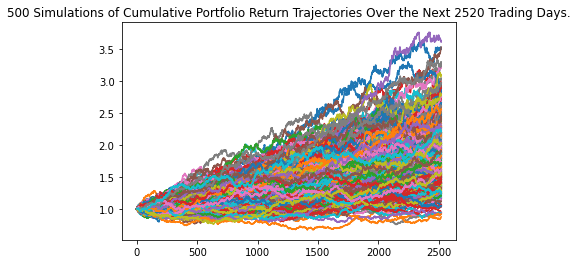

In [19]:
# Plot simulation outcomes
MC_stocks_10years.plot_simulation()

<AxesSubplot:title={'center':'Distribution of Final Cumuluative Returns Across All 500 Simulations'}, ylabel='Frequency'>

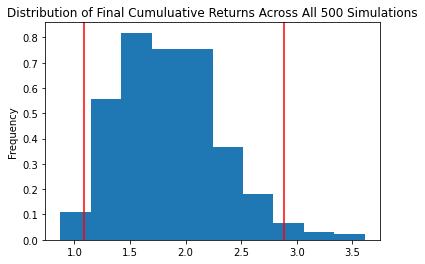

In [20]:
# Plot probability distribution and confidence intervals
MC_stocks_10years.plot_distribution()

In [21]:
# Fetch summary statistics from the Monte Carlo simulation results
results_10years= MC_stocks_10years.summarize_cumulative_return()

# Print summary statistics
print(results_10years)

count           500.000000
mean              1.858660
std               0.466763
min               0.873421
25%               1.505132
50%               1.839555
75%               2.163951
max               3.610452
95% CI Lower      1.090634
95% CI Upper      2.886986
Name: 2520, dtype: float64


In [22]:
# Set initial investment
initial_investment= 60000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
ci_lower_ten = round(results_10years[8]*60000,2)
ci_upper_ten = round(results_10years[9]*60000,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 5 years will end within in the range of $65438.07 and $173219.18
